In [ ]:
! pip install thop

### test dataset

> @inproceedings{silva2020study,
  title={A study on tooth segmentation and numbering using end-to-end deep neural networks},
  author={Silva, Bernardo and Pinheiro, Laís and Oliveira, Luciano and Pithon, Matheus}
  booktitle={Conference on Graphics, Patterns and Images (SIBGRAPI)},
  year={2020},
  organization={IEEE}
}

In [ ]:
IMG_PATH = './drive/MyDrive/dns-panoramic-images-ivisionlab/instance-segmentation/folds'

IMG_PATH1 = './drive/MyDrive/dns-panoramic-images-ivisionlab/instance-segmentation/folds/fold1/images'
IMG_PATH2 = './drive/MyDrive/dns-panoramic-images-ivisionlab/instance-segmentation/folds/fold2/images'
IMG_PATH3 = './drive/MyDrive/dns-panoramic-images-ivisionlab/instance-segmentation/folds/fold3/images'
IMG_PATH4 = './drive/MyDrive/dns-panoramic-images-ivisionlab/instance-segmentation/folds/fold4/images'
IMG_TARGET = './drive/MyDrive/binary_masks/'

IMG_PATH5 = './drive/MyDrive/dns-panoramic-images-ivisionlab/instance-segmentation/folds/fold5/images'
JSON_FILEPATH = './drive/MyDrive/dns-panoramic-images-ivisionlab/instance-segmentation/complete-json/dns-panoramic-images.json'

IMG_PATH_BINARY = './drive/MyDrive/dns-panoramic-images-ivisionlab/semantic-segmentation'
IMG_PATH6 = './drive/MyDrive/dns-panoramic-images-ivisionlab/semantic-segmentation/images'
IMG_PATH6_TARGET = './drive/MyDrive/dns-panoramic-images-ivisionlab/semantic-segmentation/masks'

In [ ]:
import torch.utils.data as data
import os
import cv2
from skimage import io
import numpy as np
from PIL import Image

class Dataset(data.Dataset):
    def __init__(self, transform_data=None, transform_labels=None):
        self.transform_data,self.transform_labels=transform_data,transform_labels

        names = []
        i=0
        imgs = []
        labels = []
        for root, dirs, imgs_name in os.walk(IMG_PATH6):
          # only for semantic segmentation training, validation and test
 
              for img in imgs_name:

                names.append(img)
                img_names = str(root)+'/'+ str(img)

                # read images:
                image = cv2.imread(img_names)
                # grayscale, convert to rgb for consistency
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                imgs.append(image)



                # print(img_names)

                img = str(img)
                mask=img.replace("jpg","png")

                

                img_names = str(IMG_PATH6_TARGET)+'/'+ str(mask)
                # print(img_names)
                # read labels:
                label = cv2.imread(img_names)
                label = cv2.cvtColor(label, cv2.COLOR_BGR2GRAY)
                labels.append(label)



        imgs = np.array(imgs)
        labels = np.array(labels)
        self.labels=labels
        self.data=imgs

    def __getitem__(self, index):
        img, target = self.data[index], self.labels[index]
        if self.transform_data:
            img = Image.fromarray(img)
            img=self.transform_data(img)
        if self.transform_labels:
            target = Image.fromarray(target)
            target=self.transform_labels(target)
        return img, target

    def __len__(self):
        return len(self.data)



In [ ]:
from torchvision import transforms
from torchvision.transforms import Compose, CenterCrop, ToTensor, Resize
import torch.nn.functional as F



def get_data(batch_size):
    data_loader = data.DataLoader(
        Dataset(
            transform_data=transforms.Compose([
                Resize((256,256)),
                ToTensor(),
                transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
                
            ]),
            transform_labels=transforms.Compose([
                Resize((256,256)),
                ToTensor(),
    
            ]),
        ),
        batch_size=batch_size,
        shuffle=True,
        num_workers=1
    )
    return data_loader



# test models

In [ ]:
# metrics.py


# batch_size should be set as 1

import cv2
import numpy as np
from scipy.spatial.distance import directed_hausdorff
import matplotlib.pyplot as plt
from skimage.io import imread
import imageio


def get_iou(mask,predict):
    # image_mask = cv2.imread(mask_name,0)
    # if np.all(image_mask == None):
    #     image_mask = imageio.mimread(mask_name)
    #     image_mask = np.array(image_mask)[0]
    #     image_mask = cv2.resize(image_mask,(576,576))
    
    # print(image.shape)
    
    image_mask = torch.squeeze(mask).cpu().numpy()
    height = predict.shape[0]
    weight = predict.shape[1]
    # print(height*weight)
    o = 0
    for row in range(height):
            for col in range(weight):
                if predict[row, col] < 0.5:
                    predict[row, col] = 0
                else:
                    predict[row, col] = 1
                if predict[row, col] == 0 or predict[row, col] == 1:
                    o += 1

    predict = predict.astype(np.int16)

    interArea = np.multiply(predict, image_mask)
    tem = predict + image_mask
    unionArea = tem - interArea
    inter = np.sum(interArea)
    union = np.sum(unionArea)
    iou_tem = inter / union

    # print('%s:iou=%f' % ("iou",iou_tem))

    return iou_tem

def get_dice(mask,predict):
    # image_mask = cv2.imread(mask_name, 0)
    # if np.all(image_mask == None):
    #     image_mask = imageio.mimread(mask_name)
    #     image_mask = np.array(image_mask)[0]
    #     image_mask = cv2.resize(image_mask,(576,576))
    
    image_mask = torch.squeeze(mask).cpu().numpy()
    height = predict.shape[0]
    weight = predict.shape[1]
    o = 0
    for row in range(height):
        for col in range(weight):
            if predict[row, col] < 0.5:
                predict[row, col] = 0
            else:
                predict[row, col] = 1
            if predict[row, col] == 0 or predict[row, col] == 1:
                o += 1

    predict = predict.astype(np.int16)
    intersection = (predict*image_mask).sum()
    dice = (2. *intersection) /(predict.sum()+image_mask.sum())
    return dice

def get_hd(mask,predict):
    # image_mask = cv2.imread(mask_name, 0)
    # # print(mask_name)
    # # print(image_mask)
    # if np.all(image_mask == None):
    #     image_mask = imageio.mimread(mask_name)
    #     image_mask = np.array(image_mask)[0]
    #     image_mask = cv2.resize(image_mask,(576,576))
    # print(mask.shape)
    # print(mask)
    image_mask = torch.squeeze(mask).cpu().numpy()
    # print(mask.shape)
    # print("####################")
    # print(predict.shape)
    # print(predict)
    

    height = predict.shape[0]
    weight = predict.shape[1]
    o = 0

    
    for row in range(height):
        for col in range(weight):
            if predict[row, col] < 0.5:
                predict[row, col] = 0
            else:
                predict[row, col] = 1
            if predict[row, col] == 0 or predict[row, col] == 1:
                o += 1
    hd1 = directed_hausdorff(image_mask, predict)[0]
    hd2 = directed_hausdorff(predict, image_mask)[0]
    res = None
    if hd1>hd2 or hd1 == hd2:
        res=hd1
        return res
    else:
        res=hd2
        return res



def show(predict):
    height = predict.shape[0]
    weight = predict.shape[1]
    for row in range(height):
        for col in range(weight):
            predict[row, col] *= 255
    plt.imshow(predict)
    plt.show()

## models

### segcap model definition

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import nn_
import torch.optim as optim

class CapsuleLayer(nn.Module):
    def __init__(self, t_0,z_0, op, k, s, t_1, z_1, routing):
        super().__init__()
        self.t_1 = t_1
        self.z_1 = z_1
        self.op = op
        self.k = k
        self.s = s
        self.routing = routing
        self.convs = nn.ModuleList()
        self.t_0=t_0
        for _ in range(t_0):
            if self.op=='conv':
                self.convs.append(nn.Conv2d(z_0, self.t_1*self.z_1, self.k, self.s,padding=2,bias=False))
            else:
                self.convs.append(nn.ConvTranspose2d(z_0, self.t_1 * self.z_1, self.k, self.s,padding=2,output_padding=1))

    def forward(self, u):  # input [N,CAPS,C,H,W]
        if u.shape[1]!=self.t_0:
            raise ValueError("Wrong type of operation for capsule")
        op = self.op
        k = self.k
        s = self.s
        t_1 = self.t_1
        z_1 = self.z_1
        routing = self.routing
        N = u.shape[0]
        H_1=u.shape[3]
        W_1=u.shape[4]
        t_0 = self.t_0

        u_t_list = [u_t.squeeze(1) for u_t in u.split(1, 1)]

        u_hat_t_list = []

        for i, u_t in zip(range(self.t_0), u_t_list):  # u_t: [N,C,H,W]
            if op == "conv":
                u_hat_t = self.convs[i](u_t)
            elif op == "deconv":
                u_hat_t = self.convs[i](u_t) #u_hat_t: [N,t_1*z_1,H,W]
            else:
                raise ValueError("Wrong type of operation for capsule")
            H_1 = u_hat_t.shape[2]
            W_1 = u_hat_t.shape[3]
            u_hat_t = u_hat_t.reshape(N, t_1,z_1,H_1, W_1).transpose_(1,3).transpose_(2,4)
            u_hat_t_list.append(u_hat_t)    #[N,H_1,W_1,t_1,z_1]
        v=self.update_routing(u_hat_t_list,k,N,H_1,W_1,t_0,t_1,routing)
        return v
    def update_routing(self,u_hat_t_list, k, N, H_1, W_1, t_0, t_1, routing):
        one_kernel = torch.ones(1, t_1, k, k).cuda()
        b = torch.zeros(N, H_1, W_1, t_0, t_1).cuda()
        b_t_list = [b_t.squeeze(3) for b_t in b.split(1, 3)]
        u_hat_t_list_sg = []
        for u_hat_t in u_hat_t_list:
            u_hat_t_sg=u_hat_t.detach()
            u_hat_t_list_sg.append(u_hat_t_sg)

        for d in range(routing):
            if d < routing - 1:
                u_hat_t_list_ = u_hat_t_list_sg
            else:
                u_hat_t_list_ = u_hat_t_list

            r_t_mul_u_hat_t_list = []
            for b_t, u_hat_t in zip(b_t_list, u_hat_t_list_):
                # routing softmax (N,H_1,W_1,t_1)
                b_t.transpose_(1, 3).transpose_(2, 3)  #[N,t_1,H_1, W_1]
                b_t_max = torch.nn.functional.max_pool2d(b_t,k,1,padding=2)
                b_t_max = b_t_max.max(1, True)[0]
                c_t = torch.exp(b_t - b_t_max)
                sum_c_t = nn_.conv2d_same(c_t, one_kernel, stride=(1, 1))  # [... , 1]
                r_t = c_t / sum_c_t  # [N,t_1, H_1, W_1]
                r_t = r_t.transpose(1, 3).transpose(1, 2)  # [N, H_1, W_1,t_1]
                r_t = r_t.unsqueeze(4)  # [N, H_1, W_1,t_1, 1]
                r_t_mul_u_hat_t_list.append(r_t * u_hat_t)  # [N, H_1, W_1, t_1, z_1]
            p = sum(r_t_mul_u_hat_t_list)  # [N, H_1, W_1, t_1, z_1]
            v = self.squash(p)
            if d < routing - 1:
                b_t_list_ = []
                for b_t, u_hat_t in zip(b_t_list, u_hat_t_list_):
                    # b_t     : [N, t_1,H_1, W_1]
                    # u_hat_t : [N, H_1, W_1, t_1, z_1]
                    # v       : [N, H_1, W_1, t_1, z_1]
                    # [N,H_1,W_1,t_1]
                    b_t.transpose_(1,3).transpose_(2,1)
                    b_t_list_.append(b_t + (u_hat_t * v).sum(4))
        v.transpose_(1, 3).transpose_(2, 4)
        # print(v.grad)
        return v
    def squash(self, p):
        p_norm_sq = (p * p).sum(-1, True)
        p_norm = (p_norm_sq + 1e-9).sqrt()
        v = p_norm_sq / (1. + p_norm_sq) * p / p_norm
        return v

In [ ]:
import torch
import torch.nn as nn
import nn_

# default n_class=2(1)

class SegCaps(nn.Module):
    def __init__(self, n_classes=1):
        super().__init__()
        self.conv_1 = nn.Sequential(
            nn.Conv2d(3, 16, 5, 1, padding=2,bias=False),

        )
        self.step_1 = nn.Sequential(  # 1/2
            CapsuleLayer(1, 16, "conv", k=5, s=2, t_1=2, z_1=16, routing=1),
            CapsuleLayer(2, 16, "conv", k=5, s=1, t_1=4, z_1=16, routing=3),
        )
        self.step_2 = nn.Sequential(  # 1/4
            CapsuleLayer(4, 16, "conv", k=5, s=2, t_1=4, z_1=32, routing=3),
            CapsuleLayer(4, 32, "conv", k=5, s=1, t_1=8, z_1=32, routing=3)
        )
        self.step_3 = nn.Sequential(  # 1/8
            CapsuleLayer(8, 32, "conv", k=5, s=2, t_1=8, z_1=64, routing=3),
            CapsuleLayer(8, 64, "conv", k=5, s=1, t_1=8, z_1=32, routing=3)
        )
        self.step_4 = CapsuleLayer(8, 32, "deconv", k=5, s=2, t_1=8, z_1=32, routing=3)

        self.step_5 = CapsuleLayer(16, 32, "conv", k=5, s=1, t_1=4, z_1=32, routing=3)

        self.step_6 = CapsuleLayer(4, 32, "deconv", k=5, s=2, t_1=4, z_1=16, routing=3)
        self.step_7 = CapsuleLayer(8, 16, "conv", k=5, s=1, t_1=4, z_1=16, routing=3)
        self.step_8 = CapsuleLayer(4, 16, "deconv", k=5, s=2, t_1=2, z_1=16, routing=3)
        self.step_10 = CapsuleLayer(3, 16, "conv", k=5, s=1, t_1=1, z_1=16, routing=3)
        self.conv_2 = nn.Sequential(
            nn.Conv2d(16, 1, 5, 1, padding=2),
        )
    def forward(self, x):
        # out = {}

        x = self.conv_1(x)
        x.unsqueeze_(1)

        skip_1 = x  # [N,1,16,H,W]

        x = self.step_1(x)

        skip_2 = x  # [N,4,16,H/2,W/2]
        x = self.step_2(x)

        skip_3 = x  # [N,8,32,H/4,W/4]

        x = self.step_3(x)  # [N,8,32,H/8,W/8]


        x = self.step_4(x)  # [N,8,32,H/4,W/4]
        x = torch.cat((x, skip_3), 1)  # [N,16,32,H/4,W/4]

        x = self.step_5(x)  # [N,4,32,H/4,W/4]

        x = self.step_6(x)  # [N,4,16,H/2,W/2]

        x = torch.cat((x, skip_2), 1)   # [N,8,16,H/2,W/2]
        x = self.step_7(x)  # [N,4,16,H/2,W/2]
        x = self.step_8(x)  # [N,2,16,H,W]

        x=torch.cat((x,skip_1),1)
        x=self.step_10(x)

        ######
        x.squeeze_(1)
        # x.shape
        v_lens = self.compute_vector_length(x)
        # v_lens.shape

        # note it for using loss function of torch
        # v_lens=v_lens.squeeze(1)
        # v_lens.shape
        


        # out['seg_output'] = v_lens
        # out['pre'] = x

        return v_lens
    def compute_vector_length(self, x):
        out = (x.pow(2)).sum(1, True)+1e-9
        out=out.sqrt()
        return out

### Unet

In [ ]:
# unet 
import torch.nn as nn
import torch
from torch import autograd
from functools import partial
import torch.nn.functional as F
from torchvision import models

class DoubleConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(DoubleConv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, input):
        return self.conv(input)


class UNet(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(UNet, self).__init__()

        self.conv1 = DoubleConv(in_ch, 32)
        self.pool1 = nn.MaxPool2d(2)
        self.conv2 = DoubleConv(32, 64)
        self.pool2 = nn.MaxPool2d(2)
        self.conv3 = DoubleConv(64, 128)
        self.pool3 = nn.MaxPool2d(2)
        self.conv4 = DoubleConv(128, 256)
        self.pool4 = nn.MaxPool2d(2)
        self.conv5 = DoubleConv(256, 512)
        self.up6 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.conv6 = DoubleConv(512, 256)
        self.up7 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv7 = DoubleConv(256, 128)
        self.up8 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv8 = DoubleConv(128, 64)
        self.up9 = nn.ConvTranspose2d(64, 32, 2, stride=2)
        self.conv9 = DoubleConv(64, 32)
        self.conv10 = nn.Conv2d(32, out_ch, 1)

    def forward(self, x):
        out={}
        #print(x.shape)
        c1 = self.conv1(x)
        p1 = self.pool1(c1)
        #print(p1.shape)
        c2 = self.conv2(p1)
        p2 = self.pool2(c2)
        #print(p2.shape)
        c3 = self.conv3(p2)
        p3 = self.pool3(c3)
        #print(p3.shape)
        c4 = self.conv4(p3)
        p4 = self.pool4(c4)
        #print(p4.shape)
        c5 = self.conv5(p4)
        up_6 = self.up6(c5)
        merge6 = torch.cat([up_6, c4], dim=1)
        c6 = self.conv6(merge6)
        up_7 = self.up7(c6)
        merge7 = torch.cat([up_7, c3], dim=1)
        c7 = self.conv7(merge7)
        up_8 = self.up8(c7)
        merge8 = torch.cat([up_8, c2], dim=1)
        c8 = self.conv8(merge8)
        up_9 = self.up9(c8)
        merge9 = torch.cat([up_9, c1], dim=1)
        c9 = self.conv9(merge9)
        c10 = self.conv10(c9)
        out['final'] = nn.Sigmoid()(c10)
        out['logits'] = c10
        out['feas'] = c9

        return out

### Unet++

In [ ]:
from torch import nn
from torch.nn import functional as F
import torch
from torchvision import models
import torchvision
class DoubleConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(DoubleConv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, input):
        return self.conv(input)

class NestedUNet(nn.Module):
    def __init__(self, deepsupervision,in_channel,out_channel):
        super().__init__()

        self.deepsupervision = deepsupervision

        nb_filter = [32, 64, 128, 256, 512]

        self.pool = nn.MaxPool2d(2, 2)
        self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)

        self.conv0_0 = DoubleConv(in_channel, nb_filter[0])
        self.conv1_0 = DoubleConv(nb_filter[0], nb_filter[1])
        self.conv2_0 = DoubleConv(nb_filter[1], nb_filter[2])
        self.conv3_0 = DoubleConv(nb_filter[2], nb_filter[3])
        self.conv4_0 = DoubleConv(nb_filter[3], nb_filter[4])

        self.conv0_1 = DoubleConv(nb_filter[0]+nb_filter[1], nb_filter[0])
        self.conv1_1 = DoubleConv(nb_filter[1]+nb_filter[2], nb_filter[1])
        self.conv2_1 = DoubleConv(nb_filter[2]+nb_filter[3], nb_filter[2])
        self.conv3_1 = DoubleConv(nb_filter[3]+nb_filter[4], nb_filter[3])

        self.conv0_2 = DoubleConv(nb_filter[0]*2+nb_filter[1], nb_filter[0])
        self.conv1_2 = DoubleConv(nb_filter[1]*2+nb_filter[2], nb_filter[1])
        self.conv2_2 = DoubleConv(nb_filter[2]*2+nb_filter[3], nb_filter[2])

        self.conv0_3 = DoubleConv(nb_filter[0]*3+nb_filter[1], nb_filter[0])
        self.conv1_3 = DoubleConv(nb_filter[1]*3+nb_filter[2], nb_filter[1])

        self.conv0_4 = DoubleConv(nb_filter[0]*4+nb_filter[1], nb_filter[0])
        self.sigmoid = nn.Sigmoid()
        if self.deepsupervision:
            self.final1 = nn.Conv2d(nb_filter[0], out_channel, kernel_size=1)
            self.final2 = nn.Conv2d(nb_filter[0], out_channel, kernel_size=1)
            self.final3 = nn.Conv2d(nb_filter[0], out_channel, kernel_size=1)
            self.final4 = nn.Conv2d(nb_filter[0], out_channel, kernel_size=1)
        else:
            self.final = nn.Conv2d(nb_filter[0], out_channel, kernel_size=1)


    def forward(self, input):
        output = {}
        x0_0 = self.conv0_0(input)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up(x1_0)], 1))

        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up(x1_1)], 1))

        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up(x1_2)], 1))

        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up(x1_3)], 1))

        if self.deepsupervision:
            output1 = self.final1(x0_1)
            output1 = self.sigmoid(output1)
            output2 = self.final2(x0_2)
            output2 = self.sigmoid(output2)
            output3 = self.final3(x0_3)
            output3 = self.sigmoid(output3)
            output4 = self.final4(x0_4)
            output4 = self.sigmoid(output4)
            return [output1, output2, output3, output4]

        else:
            output['logits'] = self.final(x0_4)
            output['final'] = self.sigmoid(self.final(x0_4))
            output['feas'] = x0_4
            return output

### R2U_Net

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class up_conv(nn.Module):
    def __init__(self,ch_in,ch_out):
        super(up_conv,self).__init__()
        self.up = nn.Sequential(
            nn.Upsample(scale_factor=2),
            nn.Conv2d(ch_in,ch_out,kernel_size=3,stride=1,padding=1,bias=True),
		    nn.BatchNorm2d(ch_out),
			nn.ReLU(inplace=True)
        )

    def forward(self,x):
        x = self.up(x)
        return x
class Recurrent_block(nn.Module):
    def __init__(self, ch_out, t=2):
        super(Recurrent_block, self).__init__()
        self.t = t
        self.ch_out = ch_out
        self.conv = nn.Sequential(
            nn.Conv2d(ch_out, ch_out, kernel_size=3, stride=1, padding=1, bias=True),
            nn.BatchNorm2d(ch_out),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        for i in range(self.t):

            if i == 0:
                x1 = self.conv(x)

            x1 = self.conv(x + x1)
        return x1

class RRCNN_block(nn.Module):
    def __init__(self,ch_in,ch_out,t=2):
        super(RRCNN_block,self).__init__()
        self.RCNN = nn.Sequential(
            Recurrent_block(ch_out,t=t),
            Recurrent_block(ch_out,t=t)
        )
        self.Conv_1x1 = nn.Conv2d(ch_in,ch_out,kernel_size=1,stride=1,padding=0)

    def forward(self,x):
        x = self.Conv_1x1(x)
        x1 = self.RCNN(x)
        return x+x1
class R2U_Net(nn.Module):
    def __init__(self, img_ch=3, output_ch=1, t=2):
        super(R2U_Net, self).__init__()

        self.Maxpool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.Upsample = nn.Upsample(scale_factor=2)

        self.RRCNN1 = RRCNN_block(ch_in=img_ch, ch_out=64, t=t)

        self.RRCNN2 = RRCNN_block(ch_in=64, ch_out=128, t=t)

        self.RRCNN3 = RRCNN_block(ch_in=128, ch_out=256, t=t)

        self.RRCNN4 = RRCNN_block(ch_in=256, ch_out=512, t=t)

        self.RRCNN5 = RRCNN_block(ch_in=512, ch_out=1024, t=t)

        self.Up5 = up_conv(ch_in=1024, ch_out=512)
        self.Up_RRCNN5 = RRCNN_block(ch_in=1024, ch_out=512, t=t)

        self.Up4 = up_conv(ch_in=512, ch_out=256)
        self.Up_RRCNN4 = RRCNN_block(ch_in=512, ch_out=256, t=t)

        self.Up3 = up_conv(ch_in=256, ch_out=128)
        self.Up_RRCNN3 = RRCNN_block(ch_in=256, ch_out=128, t=t)

        self.Up2 = up_conv(ch_in=128, ch_out=64)
        self.Up_RRCNN2 = RRCNN_block(ch_in=128, ch_out=64, t=t)

        self.Conv_1x1 = nn.Conv2d(64, output_ch, kernel_size=1, stride=1, padding=0)
        self.sigmoid = nn.Sigmoid()
    def forward(self, x):
        out = {}
        # encoding path
        x1 = self.RRCNN1(x)

        x2 = self.Maxpool(x1)
        x2 = self.RRCNN2(x2)

        x3 = self.Maxpool(x2)
        x3 = self.RRCNN3(x3)

        x4 = self.Maxpool(x3)
        x4 = self.RRCNN4(x4)

        x5 = self.Maxpool(x4)
        x5 = self.RRCNN5(x5)

        # decoding + concat path
        d5 = self.Up5(x5)
        d5 = torch.cat((x4, d5), dim=1)
        d5 = self.Up_RRCNN5(d5)

        d4 = self.Up4(d5)
        d4 = torch.cat((x3, d4), dim=1)
        d4 = self.Up_RRCNN4(d4)

        d3 = self.Up3(d4)
        d3 = torch.cat((x2, d3), dim=1)
        d3 = self.Up_RRCNN3(d3)

        d2 = self.Up2(d3)
        d2 = torch.cat((x1, d2), dim=1)
        d2 = self.Up_RRCNN2(d2)

        d1 = self.Conv_1x1(d2)
        out['final'] = self.sigmoid(d1)
        out['logits'] = d1
        out['feas'] = d2
        return out

### unet_16

In [ ]:
# student network architecture
# reference: Distilling the Knowledge in a Neural Network - Geoffrey Hinton, Oriol Vinyals, Jeff Dean

# Structured Knowledge Distillation for Dense Prediction - Yifan Liu, Changyong Shun, Jingdong Wang, Chunhua Shen

# On Compressing U-net Using Knowledge Distillation - Karttikeya Mangalam, Mathieu Salzamann



import torch.nn as nn
import torch
from torch import autograd
from functools import partial
import torch.nn.functional as F
from torchvision import models

class DoubleConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(DoubleConv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, input):
        return self.conv(input)


class UNet_16(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(UNet_16, self).__init__()

        self.conv1 = DoubleConv(in_ch, 16)
        self.pool1 = nn.MaxPool2d(2)
        self.conv2 = DoubleConv(16, 32)
        self.pool2 = nn.MaxPool2d(2)
        self.conv3 = DoubleConv(32, 64)
        self.pool3 = nn.MaxPool2d(2)
        self.conv4 = DoubleConv(64, 128)
        self.pool4 = nn.MaxPool2d(2)
        self.conv5 = DoubleConv(128, 256)
        self.up6 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.conv6 = DoubleConv(256, 128)
        self.up7 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.conv7 = DoubleConv(128, 64)
        self.up8 = nn.ConvTranspose2d(64, 32, 2, stride=2)
        self.conv8 = DoubleConv(64, 32)
        self.up9 = nn.ConvTranspose2d(32, 16, 2, stride=2)
        self.conv9 = DoubleConv(32, 16)
        self.conv10 = nn.Conv2d(16, out_ch, 1)

    def forward(self, x):
        out={}
        #print(x.shape)
        c1 = self.conv1(x)
        p1 = self.pool1(c1)
        #print(p1.shape)
        c2 = self.conv2(p1)
        p2 = self.pool2(c2)
        #print(p2.shape)
        c3 = self.conv3(p2)
        p3 = self.pool3(c3)
        #print(p3.shape)
        c4 = self.conv4(p3)
        p4 = self.pool4(c4)
        #print(p4.shape)
        c5 = self.conv5(p4)
        up_6 = self.up6(c5)
        merge6 = torch.cat([up_6, c4], dim=1)
        c6 = self.conv6(merge6)
        up_7 = self.up7(c6)
        merge7 = torch.cat([up_7, c3], dim=1)
        c7 = self.conv7(merge7)
        up_8 = self.up8(c7)
        merge8 = torch.cat([up_8, c2], dim=1)
        c8 = self.conv8(merge8)
        up_9 = self.up9(c8)
        merge9 = torch.cat([up_9, c1], dim=1)
        c9 = self.conv9(merge9)
        c10 = self.conv10(c9)
        out['final'] = nn.Sigmoid()(c10)
        out['logits'] = c10
        out['feas'] = c9

        return out

## test function

In [ ]:
import os
import numpy as np



def test_kd(val_dataloaders, model, save_predict=False, distill=False):
    logging.info('final test........')
    if distill == False:
          if save_predict ==True:
              
              dir = os.path.join(r'./saved_dis_predict',str(args.test_model))
              if not os.path.exists(dir):
                  os.makedirs(dir)
              else:
                  print('dir already exist!')
    else: 
          if save_predict ==True:
                
              dir = os.path.join(r'./saved_dis_predict',str(args.distill_version),str(args.teacher_model))
              if not os.path.exists(dir):
                  os.makedirs(dir)
              else:
                  print('dir already exist!')
    model.eval()

    #plt.ion()
    with torch.no_grad():
        i=0
        miou_total = 0
        hd_total = 0
        dice_total = 0
        std_d = []
        num = len(val_dataloaders)
        # for pic,_,pic_path,mask_path in val_dataloaders:
        for data,target in val_dataloaders:
            data = data.to(device)
            predict = model(data)['final']
            if args.deepsupervision:
                predict = torch.squeeze(predict[-1]).cpu().numpy()
            else:
                predict = torch.squeeze(predict).cpu().numpy()
            #img_y = torch.squeeze(y).cpu().numpy()

            iou = get_iou(target,predict)
            miou_total += iou
            hd_total += get_hd(target, predict)
            dice = get_dice(target,predict)
            # std_d is for computing std of dice
            std_d.append(dice)

            dice_total += dice


            # print(target.shape)
            fig = plt.figure()
            ax1 = fig.add_subplot(1, 3, 1)
            ax1.set_title('input')
            # show input
            ori_img = data.cpu()
            # print(ori_img.shape)
            # revise shape from (3,512,512) to (512,512,3) for imshow()
            img1_channel1=ori_img.numpy()[0,:,:,:][0,:,:][:,:,None]#array(512, 512, 1)
            img1_channel2=ori_img.numpy()[0,:,:,:][1,:,:][:,:,None]#array(512, 512, 1)
            img1_channel3=ori_img.numpy()[0,:,:,:][2,:,:][:,:,None]#array(512, 512, 1)

            ori_img=np.concatenate((img1_channel1,img1_channel2,img1_channel3),axis=-1)

            plt.imshow(ori_img)

            #print(pic_path[0])
            ax2 = fig.add_subplot(1, 3, 2)
            ax2.set_title('predict')
            plt.imshow(predict,cmap='Greys_r')

            ax3 = fig.add_subplot(1, 3, 3)
            ax3.set_title('mask')
            # show target
            plt.imshow(target[0][0], cmap='Greys_r')

            #print(mask_path[0])
            if save_predict == True:
                  plt.savefig(dir +'/'+ str(i)+ '.jpg')
            #plt.pause(0.01)
            print('iou={},dice={}'.format(iou,dice))
            if i < num:i+=1
        #plt.show()
        print('Miou=%f,aver_hd=%f,dv=%f,std_dice=%f' % (miou_total/num,hd_total/num,dice_total/num, np.std(std_d)))
        logging.info('Miou=%f,aver_hd=%f,dv=%f,std_dice=%f' % (miou_total/num,hd_total/num,dice_total/num, np.std(std_d)))
        #print('M_dice=%f' % (dice_total / num))

## test

### load data


In [ ]:
test_loader = get_data(1)

## main

In [ ]:
import argparse
import os
import logging

def getArgs():
    parse = argparse.ArgumentParser()
    parse.add_argument('--deepsupervision', default=0)
    # parse.add_argument("--action", type=str, help="train/test/train&test", default="train&test")
    parse.add_argument("--epoch", type=int, default=61)
    # parse.add_argument('--arch', '-a', metavar='ARCH', default='resnet34_unet',
    #                    help='UNet/resnet34_unet/unet++/myChannelUnet/Attention_UNet/segnet/r2unet/fcn32s/fcn8s')
    # batch_size have to be 1
    parse.add_argument("--batch_size", type=int, default=1)
    # parse.add_argument('--dataset', default='driveEye',  # dsb2018_256
    #                    help='dataset name:liver/esophagus/dsb2018Cell/corneal/driveEye/isbiCell/kaggleLung')
    # parse.add_argument("--ckp", type=str, help="the path of model weight file")
    
    parse.add_argument("--learning_rate",type=float,default=0.001)
    parse.add_argument("--log_dir", default='result/log', help="log dir")
    parse.add_argument("--threshold",type=float,default=None)
    parse.add_argument("--weight_name", default='_1_31', help="name of pth file")

    parse.add_argument("--distill_version", default='kc', help="choose from kd, fitnet, at and kc")

    # todo: using experiments to choose a good value for these hyperparameters, have to use real data
    parse.add_argument("--temperature", type=int, default=4)
    parse.add_argument("--alpha", type=float, default=0.05)
    parse.add_argument("--beta", type=float, default=0.005)
    parse.add_argument("--gama", type=float, default=10000)

    # to choose a architecture as teacher model
    # while student model architecture is constant in this pipeline
    parse.add_argument("--teacher_model", default='R2U_Net', help="choose from UNet, NestedUNet and R2U_Net")
    parse.add_argument("--test_model", default='UNet16', help="choose from UNet, UNet16, NestedUNet and R2U_Net")

    parse.add_argument("-f", help="a dummy argument to fool ipython", default="1")
    args = parse.parse_args()
    return args

def getLog(arg):
    # "arg" should be a input value of this function
    dirname = os.path.join(arg.log_dir,str(arg.batch_size),str(arg.epoch))
    filename = dirname +'/log.log'
    if not os.path.exists(dirname):
        os.makedirs(dirname)
    logging.basicConfig(
            filename=filename,
            level=logging.DEBUG,
            format='%(asctime)s:%(levelname)s:%(message)s'
        )
    return logging

iou=0.8613250851631165,dice=0.9254967463152747
iou=0.8453242778778076,dice=0.9161797170975412
iou=0.8515062928199768,dice=0.9197984546176171
iou=0.8314591646194458,dice=0.9079745711863446
iou=0.8488308787345886,dice=0.9182352554088544
iou=0.8907976150512695,dice=0.9422453322869201
iou=0.851141631603241,dice=0.9195856927827541
iou=0.8227840662002563,dice=0.9027773584208011
iou=0.843551754951477,dice=0.9151375078229241
iou=0.8586442470550537,dice=0.9239468361929298
iou=0.7270849943161011,dice=0.8419793255099233
iou=0.8581331372261047,dice=0.923650905294345
iou=0.8643904328346252,dice=0.9272633685898478
iou=0.8872808218002319,dice=0.9402742905528406
iou=0.8817248940467834,dice=0.9371454025209857
iou=0.8684834241867065,dice=0.9296131965143379
iou=0.6417218446731567,dice=0.7817668455453138
iou=0.6830534338951111,dice=0.8116836190958322
iou=0.8819122910499573,dice=0.9372512017083977
iou=0.8579365015029907,dice=0.9235368969081521


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


iou=0.8402157425880432,dice=0.9131709114550551
iou=0.7244694232940674,dice=0.8402229907568686
iou=0.8533365726470947,dice=0.9208652708348083
iou=0.8493208289146423,dice=0.9185219271932507
iou=0.842006266117096,dice=0.9142273780286798
iou=0.8283603191375732,dice=0.9061237223823482
iou=0.8363087177276611,dice=0.9108585120544552
iou=0.8377849459648132,dice=0.9117333217538813
iou=0.8732510209083557,dice=0.932337387439697
iou=0.7958273887634277,dice=0.8863071694329399
iou=0.8088487982749939,dice=0.8943244033137936
iou=0.8727138638496399,dice=0.9320311797911353
iou=0.7451676726341248,dice=0.8539783171024372
iou=0.8783996105194092,dice=0.9352638624200196
iou=0.679397463798523,dice=0.8090967004025724
iou=0.8477729558944702,dice=0.9176159495917575
iou=0.8573501706123352,dice=0.9231971227454175
iou=0.8185201287269592,dice=0.9002046469951581
iou=0.7860280871391296,dice=0.8801967974454705
iou=0.8715857267379761,dice=0.931387441708989
iou=0.868467390537262,dice=0.9296039972579843
iou=0.871067225933

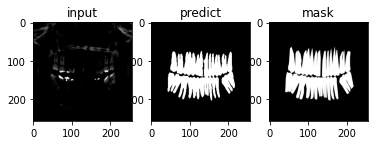

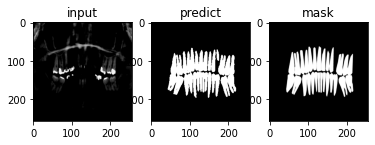

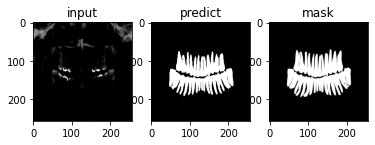

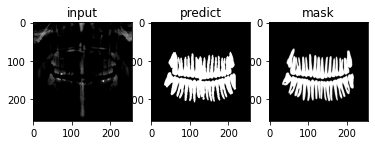

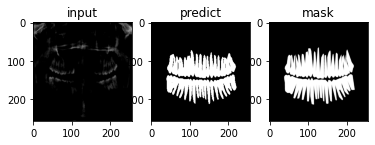

...

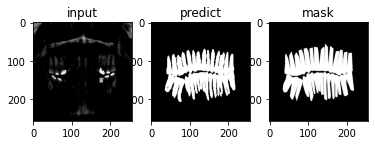

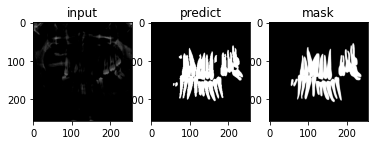

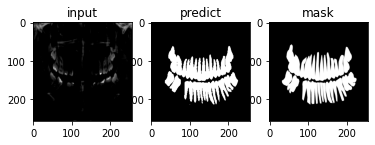

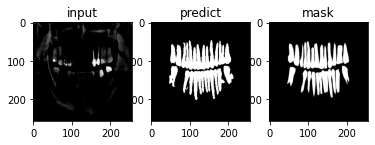

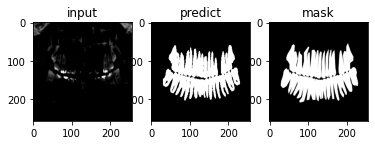

In [ ]:
# test
from thop import profile

args = getArgs()
logging = getLog(args)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

temp_dl = torch.FloatTensor(torch.randn(1, 3, 256, 256)).cuda()


# model = SegCaps()

model = UNet_16(3, 1)
# model = NestedUNet(0,in_channel=3,out_channel=1)
# model = R2U_Net()
# model = UNet(3,1)

# for teachers or UNet16
# model.load_state_dict(torch.load(r'./saved_model/'+'_'+str(args.batch_size)+'_'+str(31)+'.pth', map_location='cpu'))
# for students
model.load_state_dict(torch.load(r'./saved_model/'+'_'+str(args.batch_size)+'_'+str(args.epoch)+'.pth', map_location='cpu'))




model.cuda()

flops, params = profile(model, inputs=(temp_dl, ), verbose=False)


logging.info("=" * 100 + "\nnetwork's flops is: {}, parameters count is: {}, params are:".format(flops, params))




# if we evaluate the result of distillation, distill=True
test_kd(test_loader, model, save_predict=True,distill=True)